# Run STitch3D on the DLPFC dataset

In this tutorial, we show STitch3D’s analysis of the human dorsolateral prefrontal cortex (DLPFC) dataset.

The spatial transcriptomics DLPFC data are publicly available at https://github.com/LieberInstitute/spatialLIBD. The DLPFC dataset profiled by 10x Genomics Chromium platform is available at https://www.ncbi.nlm.nih.gov/geo/query/acc.cgi?acc=GSE144136.

## Import packages

In [1]:
import pandas as pd
import numpy as np
import scanpy as sc
import anndata as ad
import scipy.io
import matplotlib.pyplot as plt
import os
import sys

import STitch3D

import warnings
warnings.filterwarnings("ignore")

os.environ["CUDA_VISIBLE_DEVICES"] = "0"

/home/xmabs/anaconda3/envs/stitch3d/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## Preprocessing

### Load datasets

Load single-cell reference dataset:

In [6]:
mat = scipy.io.mmread("/home/share/portal/reproduce/DLPFC/data/snRNAseq_brain/GSE144136_GeneBarcodeMatrix_Annotated.mtx")
meta = pd.read_csv("/home/share/portal/reproduce/DLPFC/data/snRNAseq_brain/GSE144136_CellNames.csv", index_col=0)
meta.index = meta.x.values
group = [i.split('.')[1].split('_')[0] for i in list(meta.x.values)]
condition = [i.split('.')[1].split('_')[1] for i in list(meta.x.values)]
celltype = [i.split('.')[0] for i in list(meta.x.values)]
meta["group"] = group
meta["condition"] = condition
meta["celltype"] = celltype
genename = pd.read_csv("/home/share/portal/reproduce/DLPFC/data/snRNAseq_brain/GSE144136_GeneNames.csv", index_col=0)
genename.index = genename.x.values
#print("mat shape:", mat.shape)
#print("genename shape:", genename.shape)
adata_ref = ad.AnnData(X=mat.tocsr().T)
adata_ref.obs = meta
adata_ref.var = genename
adata_ref = adata_ref[adata_ref.obs.condition.values.astype(str)=="Control", :]

Load spatial transcriptomics datasets:

In [7]:
#spatial data
anno_df = pd.read_csv('/home/share/portal/reproduce/DLPFC/data/spatialLIBD/barcode_level_layer_map.tsv', sep='\t', header=None)

slice_idx = [151673, 151674, 151675, 151676]

adata_st1 = sc.read_visium(path="/home/share/portal/reproduce/DLPFC/data/spatialLIBD/%d" % slice_idx[0],
                          count_file="%d_filtered_feature_bc_matrix.h5" % slice_idx[0])
anno_df1 = anno_df.iloc[anno_df[1].values.astype(str) == str(slice_idx[0])]
anno_df1.columns = ["barcode", "slice_id", "layer"]
anno_df1.index = anno_df1['barcode']
adata_st1.obs = adata_st1.obs.join(anno_df1, how="left")
adata_st1 = adata_st1[adata_st1.obs['layer'].notna()]

adata_st2 = sc.read_visium(path="/home/share/portal/reproduce/DLPFC/data/spatialLIBD/%d" % slice_idx[1],
                          count_file="%d_filtered_feature_bc_matrix.h5" % slice_idx[1])
anno_df2 = anno_df.iloc[anno_df[1].values.astype(str) == str(slice_idx[1])]
anno_df2.columns = ["barcode", "slice_id", "layer"]
anno_df2.index = anno_df2['barcode']
adata_st2.obs = adata_st2.obs.join(anno_df2, how="left")
adata_st2 = adata_st2[adata_st2.obs['layer'].notna()]

adata_st3 = sc.read_visium(path="/home/share/portal/reproduce/DLPFC/data/spatialLIBD/%d" % slice_idx[2],
                          count_file="%d_filtered_feature_bc_matrix.h5" % slice_idx[2])
anno_df3 = anno_df.iloc[anno_df[1].values.astype(str) == str(slice_idx[2])]
anno_df3.columns = ["barcode", "slice_id", "layer"]
anno_df3.index = anno_df3['barcode']
adata_st3.obs = adata_st3.obs.join(anno_df3, how="left")
adata_st3 = adata_st3[adata_st3.obs['layer'].notna()]

adata_st4 = sc.read_visium(path="/home/share/portal/reproduce/DLPFC/data/spatialLIBD/%d" % slice_idx[3],
                          count_file="%d_filtered_feature_bc_matrix.h5" % slice_idx[3])
anno_df4 = anno_df.iloc[anno_df[1].values.astype(str) == str(slice_idx[3])]
anno_df4.columns = ["barcode", "slice_id", "layer"]
anno_df4.index = anno_df4['barcode']
adata_st4.obs = adata_st4.obs.join(anno_df4, how="left")
adata_st4 = adata_st4[adata_st4.obs['layer'].notna()]

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


### Alignment of ST tissue slices



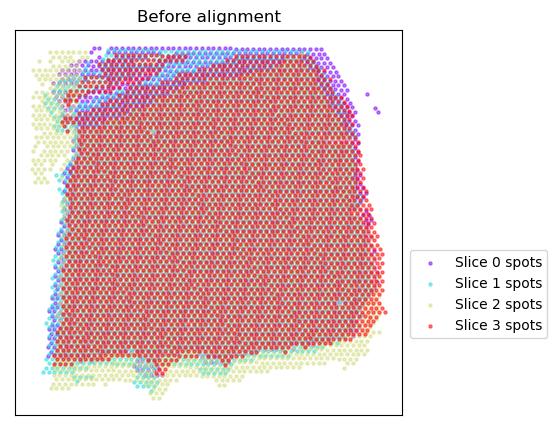

Using the Iterative Closest Point algorithm for alignemnt.
Detecting edges...


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Aligning edges...


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


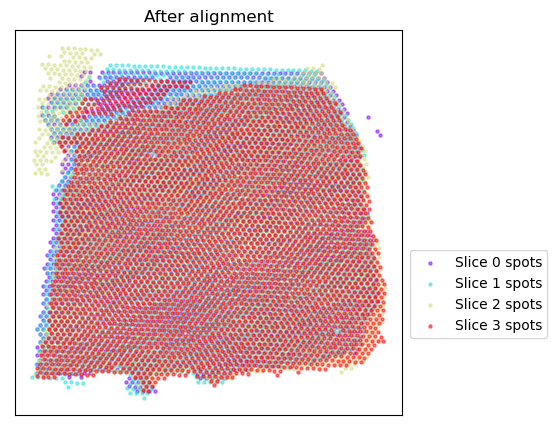

In [8]:
adata_st_list_raw = [adata_st1, adata_st2, adata_st3, adata_st4]
adata_st_list = STitch3D.utils.align_spots(adata_st_list_raw, plot=True)

### Selecting highly variable genes and building 3D spatial graph




In [9]:
celltype_list_use = ['Astros_1', 'Astros_2', 'Astros_3', 'Endo', 'Micro/Macro',
                     'Oligos_1', 'Oligos_2', 'Oligos_3',
                     'Ex_1_L5_6', 'Ex_2_L5', 'Ex_3_L4_5', 'Ex_4_L_6', 'Ex_5_L5',
                     'Ex_6_L4_6', 'Ex_7_L4_6', 'Ex_8_L5_6', 'Ex_9_L5_6', 'Ex_10_L2_4']

adata_st, adata_basis = STitch3D.utils.preprocess(adata_st_list,
                                                  adata_ref,
                                                  celltype_ref=celltype_list_use,
                                                  sample_col="group",
                                                  slice_dist_micron=[10., 300., 10.],
                                                  n_hvg_group=500)

Finding highly variable genes...


Trying to set attribute `.obs` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Trying to set attribute `.obs` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Trying to set attribute `.obs` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Trying to set attribute `.obs` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
... storing 'condition' as categorical
... storing 'celltype' as categorical


4558 highly variable genes selected.
Calculate basis for deconvolution...


Trying to set attribute `.obs` of view, copying.


1 batches are used for computing the basis vector of cell type <Astros_1>.
17 batches are used for computing the basis vector of cell type <Astros_2>.
14 batches are used for computing the basis vector of cell type <Astros_3>.
17 batches are used for computing the basis vector of cell type <Endo>.
17 batches are used for computing the basis vector of cell type <Ex_10_L2_4>.
15 batches are used for computing the basis vector of cell type <Ex_1_L5_6>.
15 batches are used for computing the basis vector of cell type <Ex_2_L5>.
17 batches are used for computing the basis vector of cell type <Ex_3_L4_5>.
14 batches are used for computing the basis vector of cell type <Ex_4_L_6>.
17 batches are used for computing the basis vector of cell type <Ex_5_L5>.
16 batches are used for computing the basis vector of cell type <Ex_6_L4_6>.
16 batches are used for computing the basis vector of cell type <Ex_7_L4_6>.
15 batches are used for computing the basis vector of cell type <Ex_8_L5_6>.
13 batches a

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Start building a graph...
Radius for graph connection is 150.7000.
9.8415 neighbors per cell on average.


## Running STitch3D model


In [10]:
model = STitch3D.model.Model(adata_st, adata_basis)

model.train()

  0%|          | 2/20000 [00:09<22:16:27,  4.01s/it]

Step: 0, Loss: 2436.9839, d_loss: 2431.3972, f_loss: 55.8676


 10%|█         | 2002/20000 [06:05<52:56,  5.67it/s]

Step: 2000, Loss: 744.6385, d_loss: 741.3370, f_loss: 33.0152


 20%|██        | 4002/20000 [12:00<47:11,  5.65it/s]

Step: 4000, Loss: 707.6378, d_loss: 704.3558, f_loss: 32.8206


 30%|███       | 6002/20000 [17:56<41:26,  5.63it/s]

Step: 6000, Loss: 697.0624, d_loss: 693.7953, f_loss: 32.6709


 40%|████      | 8002/20000 [23:52<35:24,  5.65it/s]

Step: 8000, Loss: 692.7398, d_loss: 689.4794, f_loss: 32.6046


 50%|█████     | 10002/20000 [29:48<29:34,  5.63it/s]

Step: 10000, Loss: 692.1715, d_loss: 688.9276, f_loss: 32.4391


 60%|██████    | 12002/20000 [35:44<23:37,  5.64it/s]

Step: 12000, Loss: 690.0596, d_loss: 686.8265, f_loss: 32.3301


 70%|███████   | 14002/20000 [41:40<17:41,  5.65it/s]

Step: 14000, Loss: 689.3466, d_loss: 686.1174, f_loss: 32.2926


 80%|████████  | 16002/20000 [47:36<11:52,  5.62it/s]

Step: 16000, Loss: 689.5353, d_loss: 686.2885, f_loss: 32.4680


 90%|█████████ | 18002/20000 [53:32<05:53,  5.66it/s]

Step: 18000, Loss: 688.6558, d_loss: 685.4315, f_loss: 32.2429


100%|██████████| 20000/20000 [59:27<00:00,  5.61it/s]


## Saving STitch3D results

In [11]:
save_path = "/home/xmabs/MATH5472/STitch3D/results_DLPFC"
result = model.eval(adata_st_list_raw, save=True, output_path=save_path)

... storing 'layer' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'layer' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'layer' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'layer' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


## Visualizing results in 2D

STitch3D’s learned representations of spots in all slices are restored in “model.adata_st.obsm[‘latent’]”, which are used for spatial domain identification.

In [12]:

from sklearn.mixture import GaussianMixture

np.random.seed(1234)
gm = GaussianMixture(n_components=7, covariance_type='tied', init_params='kmeans')
y = gm.fit_predict(model.adata_st.obsm['latent'], y=None)
model.adata_st.obs["GM"] = y
model.adata_st.obs["GM"].to_csv(os.path.join(save_path, "clustering_result.csv"))

# Restoring clustering labels to result
order = [2,4,6,0,3,5,1] # reordering cluster labels
model.adata_st.obs["Cluster"] = [order[label] for label in model.adata_st.obs["GM"].values]
for i in range(len(result)):
    result[i].obs["GM"] = model.adata_st.obs.loc[result[i].obs_names, ]["GM"]
    result[i].obs["Cluster"] = model.adata_st.obs.loc[result[i].obs_names, ]["Cluster"]

Plotting spatial domains:

Slice 151673 spatial domain detection result:


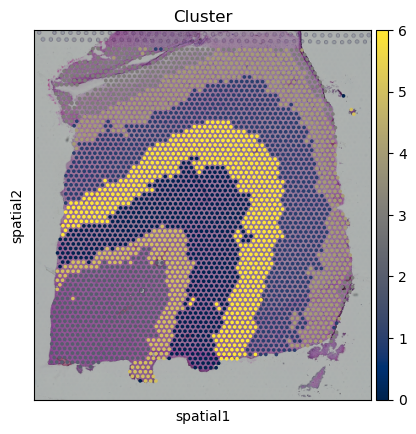

Slice 151674 spatial domain detection result:


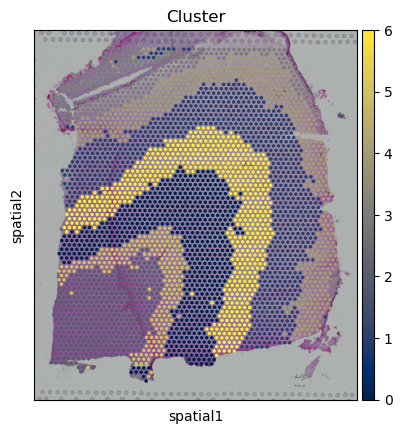

Slice 151675 spatial domain detection result:


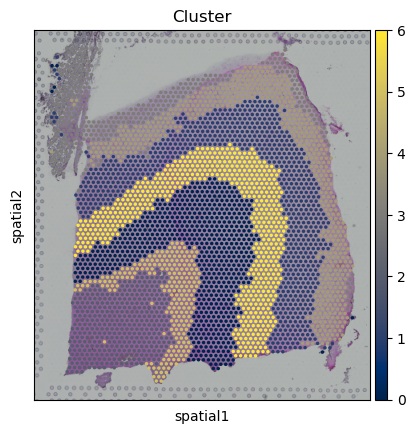

Slice 151676 spatial domain detection result:


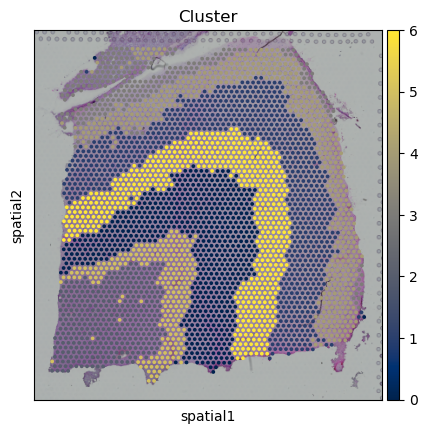

In [13]:
for i, adata_st_i in enumerate(result):
    print("Slice %d spatial domain detection result:" % slice_idx[i])
    sc.pl.spatial(adata_st_i, img_key="lowres", color="Cluster", color_map="cividis", size=1.)

Plotting cell-type proportions:

Slice 151673 cell-type deconvolution result:


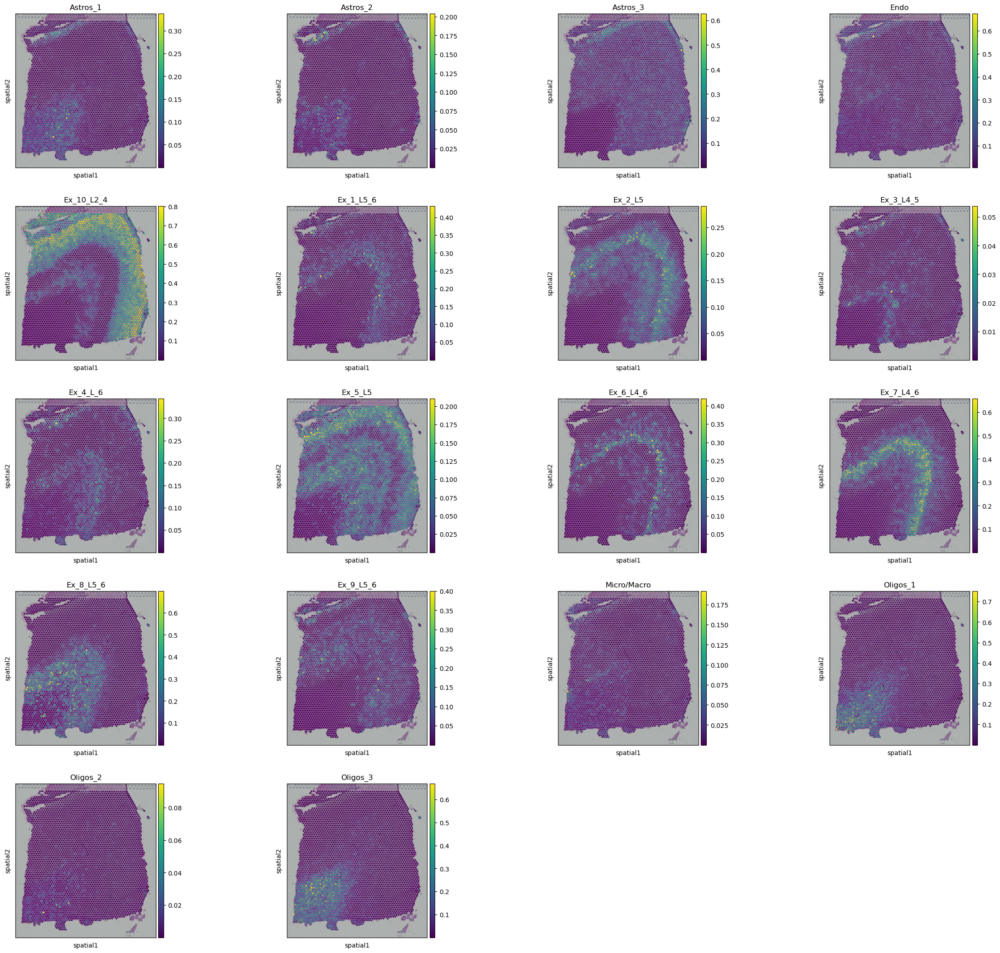

Slice 151674 cell-type deconvolution result:


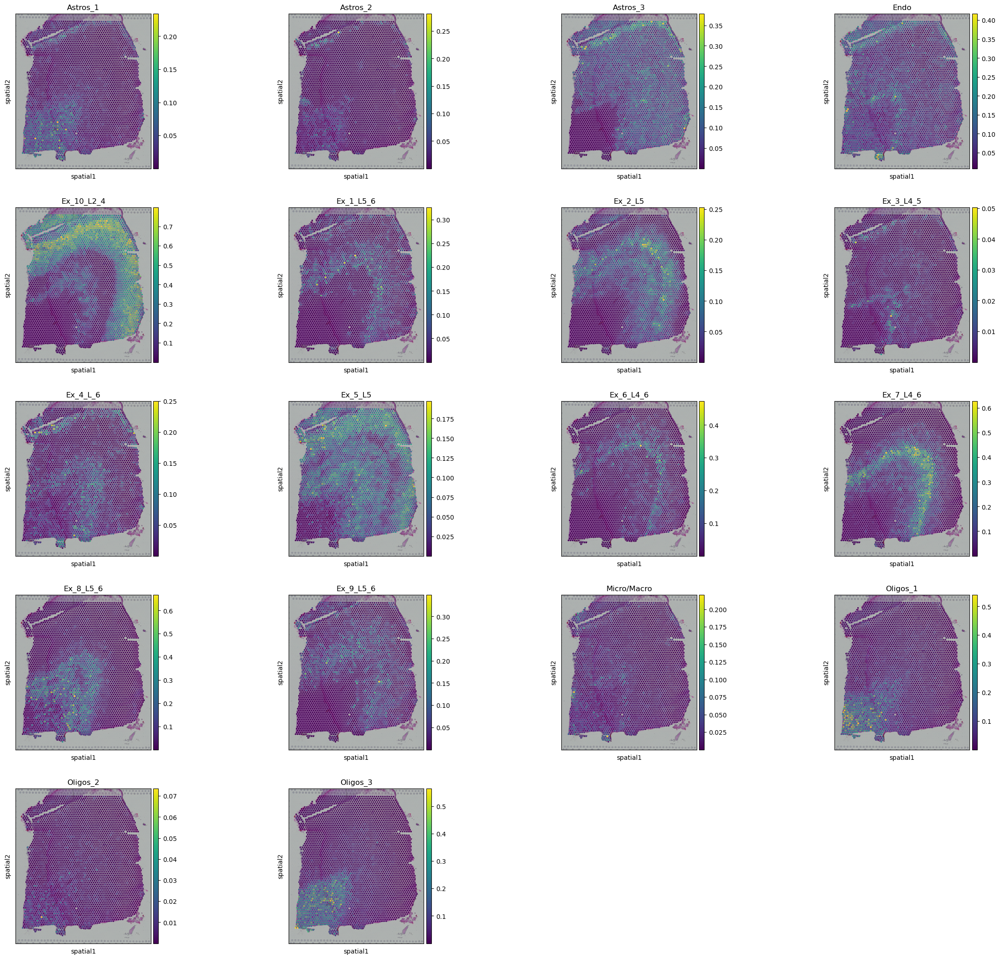

Slice 151675 cell-type deconvolution result:


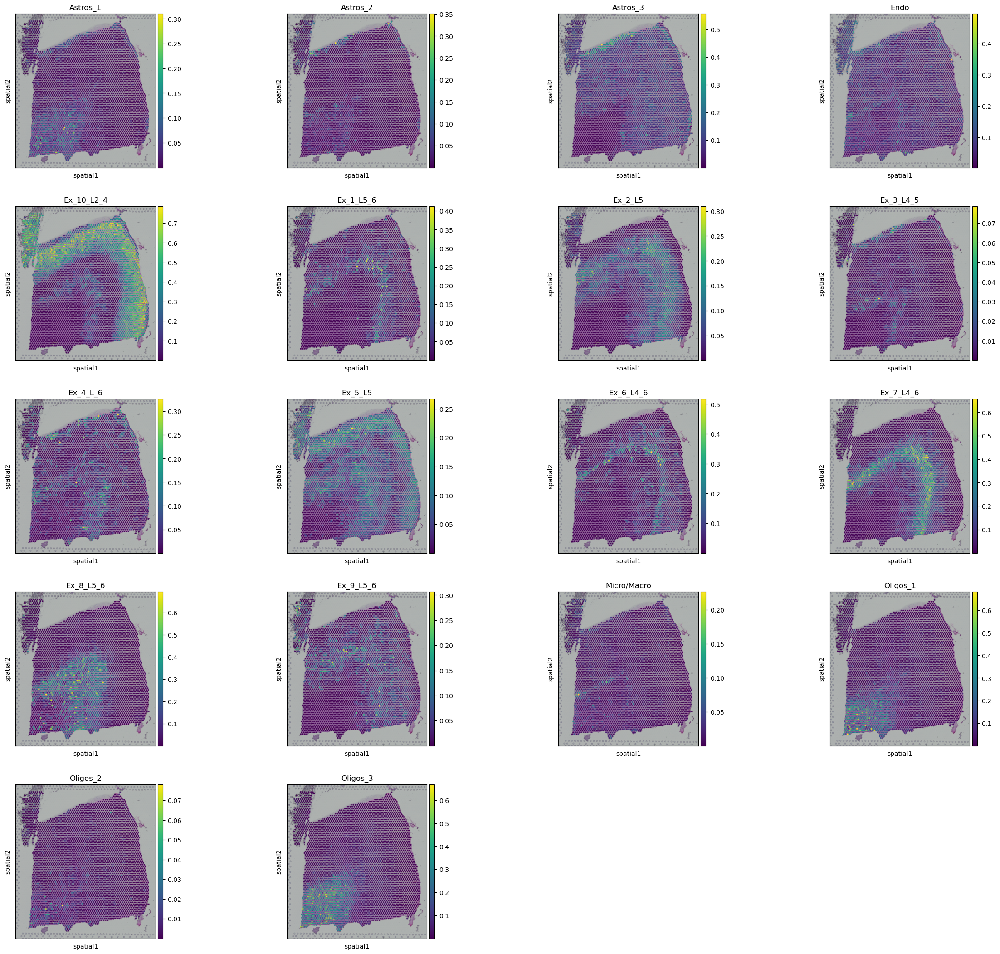

Slice 151676 cell-type deconvolution result:


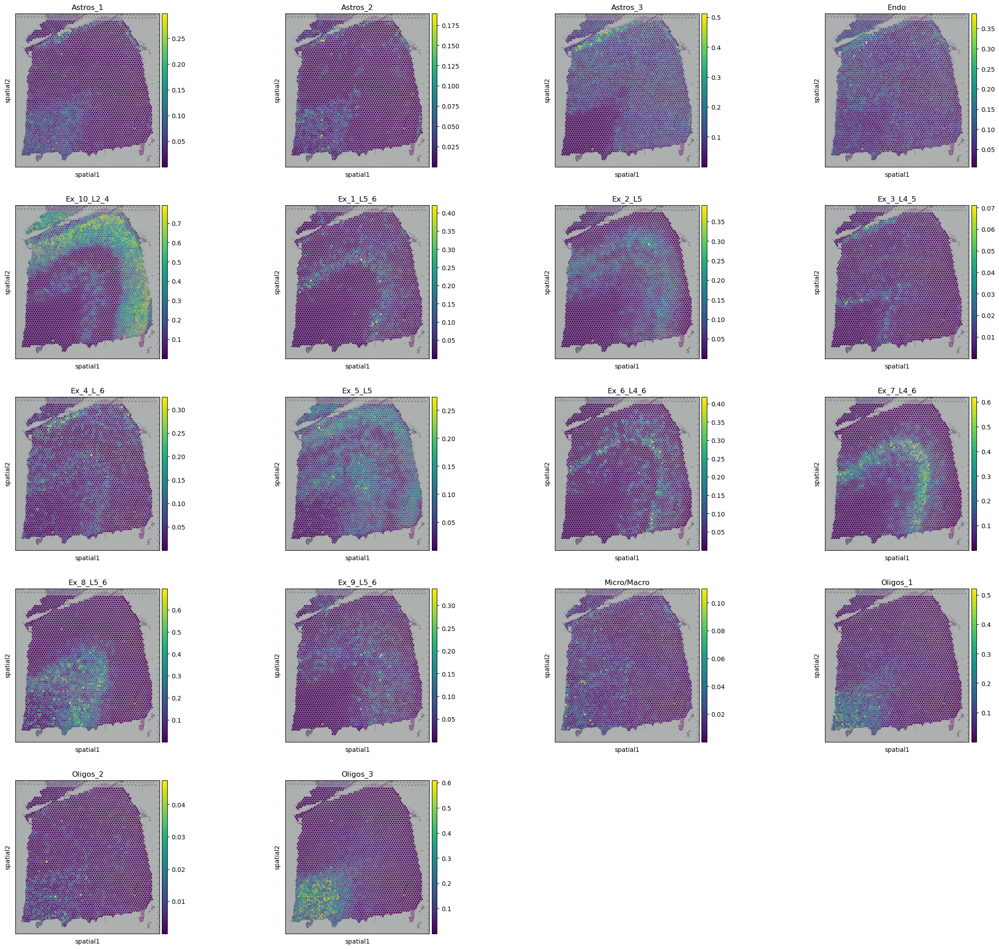

In [14]:
for i, adata_st_i in enumerate(result):
    print("Slice %d cell-type deconvolution result:" % slice_idx[i])
    sc.pl.spatial(adata_st_i, img_key="lowres", color=list(adata_basis.obs.index), size=1.)

Plotting UMAP:

In [15]:
import umap

reducer = umap.UMAP(n_neighbors=30,
                    n_components=2,
                    metric="correlation",
                    n_epochs=None,
                    learning_rate=1.0,
                    min_dist=0.3,
                    spread=1.0,
                    set_op_mix_ratio=1.0,
                    local_connectivity=1,
                    repulsion_strength=1,
                    negative_sample_rate=5,
                    a=None,
                    b=None,
                    random_state=1234,
                    metric_kwds=None,
                    angular_rp_forest=False,
                    verbose=True)

embedding = reducer.fit_transform(model.adata_st.obsm['latent'])

n_spots = embedding.shape[0]
size = 120000 / n_spots

UMAP(angular_rp_forest=True, local_connectivity=1, metric='correlation', min_dist=0.3, n_jobs=1, n_neighbors=30, random_state=1234, repulsion_strength=1, verbose=True)
Sun Dec 15 01:16:39 2024 Construct fuzzy simplicial set
Sun Dec 15 01:16:39 2024 Finding Nearest Neighbors
Sun Dec 15 01:16:39 2024 Building RP forest with 11 trees
Sun Dec 15 01:16:42 2024 NN descent for 14 iterations
	 1  /  14
	 2  /  14
	 3  /  14
	Stopping threshold met -- exiting after 3 iterations
Sun Dec 15 01:16:54 2024 Finished Nearest Neighbor Search
Sun Dec 15 01:16:56 2024 Construct embedding


Epochs completed:   4%| ▍          9/200 [00:00]

	completed  0  /  200 epochs


Epochs completed:  14%| █▎         27/200 [00:01]

	completed  20  /  200 epochs


Epochs completed:  24%| ██▍        48/200 [00:02]

	completed  40  /  200 epochs


Epochs completed:  34%| ███▍       69/200 [00:03]

	completed  60  /  200 epochs


Epochs completed:  44%| ████▎      87/200 [00:04]

	completed  80  /  200 epochs


Epochs completed:  54%| █████▍     108/200 [00:05]

	completed  100  /  200 epochs


Epochs completed:  64%| ██████▍    129/200 [00:06]

	completed  120  /  200 epochs


Epochs completed:  74%| ███████▎   147/200 [00:07]

	completed  140  /  200 epochs


Epochs completed:  84%| ████████▍  168/200 [00:08]

	completed  160  /  200 epochs


Epochs completed:  94%| █████████▍ 189/200 [00:09]

	completed  180  /  200 epochs


Epochs completed: 100%| ██████████ 200/200 [00:09]

Sun Dec 15 01:17:08 2024 Finished embedding


Obtaining spatial trajectory with PAGA (https://scanpy.readthedocs.io/en/stable/generated/scanpy.tl.paga.html).

In [24]:
model.adata_st.obsm["X_umap"] = embedding
sc.pp.neighbors(model.adata_st, use_rep='latent')

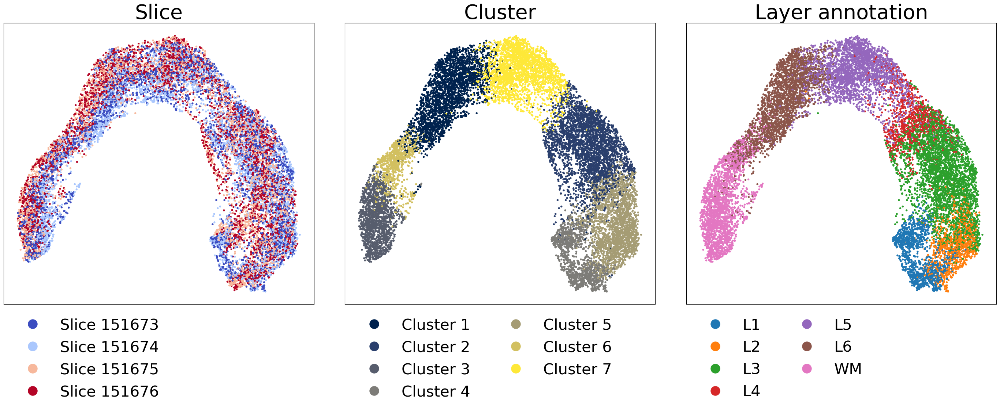

In [25]:
from sklearn import preprocessing
from matplotlib.colors import ListedColormap

le_slice = preprocessing.LabelEncoder()
label_slice = le_slice.fit_transform(model.adata_st.obs['slice_id'])

le_layer = preprocessing.LabelEncoder()
label_layer = le_layer.fit_transform(model.adata_st.obs['layer'])

np.random.seed(1234)
order = np.arange(n_spots)
np.random.shuffle(order)

# 修改图形大小为3列
f = plt.figure(figsize=(35,10))

# 第一张图
ax1 = f.add_subplot(1,3,1)
scatter1 = ax1.scatter(embedding[order, 0], embedding[order, 1],
                       s=size, c=label_slice[order], cmap='coolwarm')
ax1.set_title("Slice", fontsize=40)
ax1.tick_params(axis='both',bottom=False, top=False, left=False, right=False, labelleft=False, labelbottom=False, grid_alpha=0)

l1 = ax1.legend(handles=scatter1.legend_elements()[0],
                labels=["Slice %d" % i for i in slice_idx],
                loc="upper left", bbox_to_anchor=(0., 0.),
                markerscale=3., title_fontsize=45, fontsize=30, frameon=False, ncol=1)
l1._legend_box.align = "left"

# 第二张图
ax2 = f.add_subplot(1,3,2)
scatter2 = ax2.scatter(embedding[order, 0], embedding[order, 1],
                       s=size, c=model.adata_st.obs['Cluster'][order], cmap='cividis')
ax2.set_title("Cluster", fontsize=40)
ax2.tick_params(axis='both',bottom=False, top=False, left=False, right=False, labelleft=False, labelbottom=False, grid_alpha=0)

l2 = ax2.legend(handles=scatter2.legend_elements()[0],
                labels=["Cluster %d" % i for i in range(1, 8)],
                loc="upper left", bbox_to_anchor=(0., 0.),
                markerscale=3., title_fontsize=45, fontsize=30, frameon=False, ncol=2)
l2._legend_box.align = "left"

# 第三张图
ax3 = f.add_subplot(1,3,3)
scatter3 = ax3.scatter(embedding[order, 0], embedding[order, 1],
                       s=size, c=label_layer[order], cmap=ListedColormap(["#1f77b4", "#ff7f0e", "#2ca02c", "#d62728", "#9467bd", "#8c564b", "#e377c2"]))
ax3.set_title("Layer annotation", fontsize=40)
ax3.tick_params(axis='both',bottom=False, top=False, left=False, right=False, labelleft=False, labelbottom=False, grid_alpha=0)

l3 = ax3.legend(handles=scatter3.legend_elements()[0],
                labels=sorted(set(adata_st.obs['layer'].values)),
                loc="upper left", bbox_to_anchor=(0., 0.),
                markerscale=3., title_fontsize=45, fontsize=30, frameon=False, ncol=2)
l3._legend_box.align = "left"

# 调整子图之间的间距
f.subplots_adjust(hspace=.1, wspace=.1)
plt.show()